In [26]:
import sys
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import os
import glob
from IPython.core.display import display, HTML
import json
from zipfile import ZipFile

import cartopy.crs as ccrs
import cartopy.feature as cfeature

import warnings
warnings.filterwarnings('ignore')

In [27]:
file_name_chl = 'chl_nn.nc'



In [28]:
OLCI_file = xr.open_dataset(os.path.join(file_name_chl))

In [29]:
OLCI_file

<xarray.Dataset>
Dimensions:     (columns: 4865, rows: 4091)
Dimensions without coordinates: columns, rows
Data variables:
    CHL_NN      (rows, columns) float32 ...
    CHL_NN_err  (rows, columns) float32 ...
Attributes: (12/16)
    absolute_orbit_number:  22724
    ac_subsampling_factor:  64
    al_subsampling_factor:  1
    comment:                 
    contact:                ops@eumetsat.int
    creation_time:          2020-06-29T18:11:38Z
    ...                     ...
    references:             S3IPF PDS 004.3 - i2r2 - Product Data Format Spec...
    resolution:             [ 270 294 ]
    source:                 IPF-OL-2 06.13
    start_time:             2020-06-28T09:28:15.649581Z
    stop_time:              2020-06-28T09:31:15.614557Z
    title:                  OLCI Level 2 WATER Product, Neutral Net Chlorophy...

In [30]:
CHL     = OLCI_file.CHL_NN.data
OLCI_file.close()

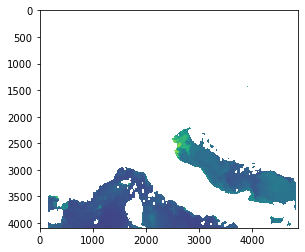

In [31]:
plt.imshow(CHL);

In [32]:
whos

Variable          Type                   Data/Info
--------------------------------------------------
AnchoredText      type                   <class 'matplotlib.offsetbox.AnchoredText'>
Basemap           type                   <class 'mpl_toolkits.basemap.Basemap'>
CHL               ndarray                4091x4865: 19902715 elems, type `float32`, 79610860 bytes (75.92283248901367 Mb)
CHL_subset        ndarray                1891x2385: 4510035 elems, type `float32`, 18040140 bytes (17.204418182373047 Mb)
FLAGS             ndarray                4091x4865: 19902715 elems, type `uint64`, 159221720 bytes (151.84566497802734 Mb)
FLAG_file         Dataset                <xarray.Dataset>\nDimensi<...> Classification, Quali...
FLAG_subset       ndarray                1891x2385: 4510035 elems, type `float64`, 36080280 bytes (34.408836364746094 Mb)
GEO_file          Dataset                <xarray.Dataset>\nDimensi<...> Geo Coordinates Data Set
HTML              type                   <class 'I

In [33]:
row1=2200
row2=4500
col1=2480
col2=4900
grid_factor=1
CHL_subset = CHL[row1:row2:grid_factor, col1:col2:grid_factor]

In [34]:
CHL_subset

array([[       nan,        nan,        nan, ...,        nan,        nan,
               nan],
       [       nan,        nan,        nan, ...,        nan,        nan,
               nan],
       [       nan,        nan,        nan, ...,        nan,        nan,
               nan],
       ...,
       [-1.2125984, -1.2125984, -1.1968504, ...,        nan,        nan,
               nan],
       [-1.1968504, -1.1968504, -1.2283465, ...,        nan,        nan,
               nan],
       [-1.1653543, -1.1653543, -1.2125984, ...,        nan,        nan,
               nan]], dtype=float32)

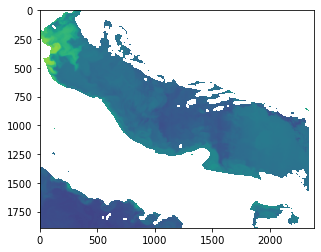

In [35]:
plt.imshow(CHL_subset);

In [36]:
file_name_geo = 'geo_coordinates.nc'
GEO_file      = xr.open_dataset(os.path.join(file_name_geo))
LAT           = GEO_file.variables['latitude'][:]
LON           = GEO_file.variables['longitude'][:]
LAT_subset    = LAT[row1:row2:grid_factor, col1:col2:grid_factor]
LON_subset    = LON[row1:row2:grid_factor, col1:col2:grid_factor]
GEO_file.close()

In [37]:
GEO_file

<xarray.Dataset>
Dimensions:    (columns: 4865, rows: 4091)
Dimensions without coordinates: columns, rows
Data variables:
    altitude   (rows, columns) int16 ...
    latitude   (rows, columns) float64 ...
    longitude  (rows, columns) float64 ...
Attributes: (12/16)
    absolute_orbit_number:  22724
    ac_subsampling_factor:  64
    al_subsampling_factor:  1
    comment:                 
    contact:                ops@eumetsat.int
    creation_time:          2020-06-29T18:11:38Z
    ...                     ...
    references:             S3IPF PDS 004.3 - i2r2 - Product Data Format Spec...
    resolution:             [ 270 294 ]
    source:                 IPF-OL-2 06.13
    start_time:             2020-06-28T09:28:15.649581Z
    stop_time:              2020-06-28T09:31:15.614557Z
    title:                  OLCI Level 2 WATER Product, Geo Coordinates Data Set

In [38]:
land_resolution = '10m'
land_cop = cfeature.NaturalEarthFeature('physical', 'land', land_resolution,
                                        edgecolor='k',
                                        facecolor=cfeature.COLORS['land'], color ='w')

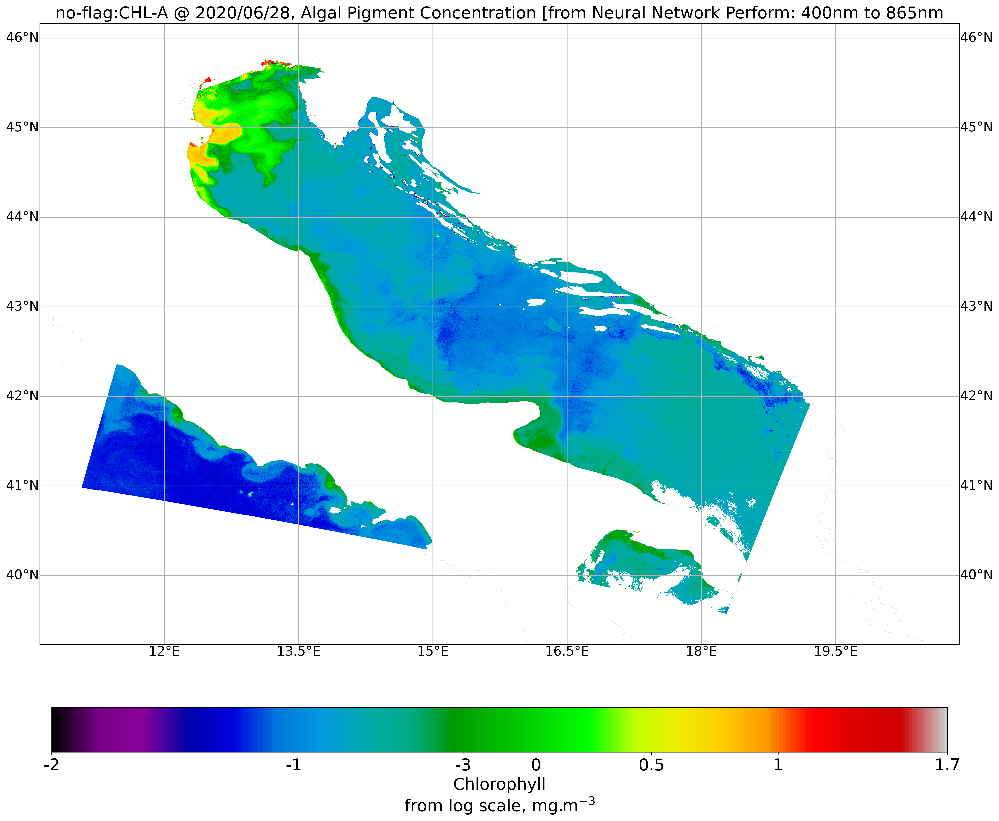

In [39]:
fig2 = plt.figure(figsize=(20, 20), dpi=400)
m = plt.axes(projection=ccrs.PlateCarree(central_longitude=0.0))


f1 = plt.pcolormesh(LON_subset,LAT_subset,np.ma.masked_invalid(CHL_subset), shading='flat', vmin=np.log10(0.01), vmax=np.log10(50), cmap=plt.cm.nipy_spectral)  
m.coastlines(resolution=land_resolution, color='black', linewidth=1)
m.add_feature(land_cop)

g1 = m.gridlines(draw_labels = True)
g1.xlabels_top = False
g1.xlabel_style = {'size': 16, 'color': 'k'}
g1.ylabel_style = {'size': 16, 'color': 'k'}

cbar = plt.colorbar(f1, orientation="horizontal", fraction=0.05, pad=0.07, ticks=[np.log10(0.01), np.log10(0.1),np.log10(0.5), np.log10(1),np.log10(3),np.log10(10),np.log10(50)]) 
cbar.ax.set_xticklabels(['-2','-1','-3','0','0.5','1','1.7'], fontsize=20) 
cbar.set_label('Chlorophyll\nfrom log scale, mg.m$^{-3}$', fontsize=20)
plt.title('no-flag:CHL-A @ 2020/06/28, Algal Pigment Concentration [from Neural Network Perform: 400nm to 865nm', fontsize=20);


plt.show()

In [40]:
def flag_data_fast(flags_we_want, flag_names, flag_values, flag_data, flag_type='WQSF'):
    flag_bits = np.uint64()
    if flag_type == 'SST':
        flag_bits = np.uint8()
    elif flag_type == 'WQSF_lsb':
        flag_bits = np.uint32()
    
    for flag in flags_we_want:
        try:
            flag_bits = flag_bits | flag_values[flag_names.index(flag)]
        except:
            print(flag + " not present")
    
    return (flag_data & flag_bits) > 0

In [41]:

flags_we_want = ['CLOUD', 'CLOUD_AMBIGUOUS', 'CLOUD_MARGIN', 'INVALID']

file_name_flags = 'wqsf.nc'
FLAG_file = xr.open_dataset(os.path.join(file_name_flags))
# get all the flag names
flag_names = FLAG_file['WQSF'].flag_meanings.split(' ')
# get all the flag bit values
flag_vals = FLAG_file['WQSF'].flag_masks
# get the flag field itself
FLAGS = FLAG_file.variables['WQSF'].data
FLAG_file.close()

# make the flag mask 
flag_mask = flag_data_fast(flags_we_want, flag_names, flag_vals, FLAGS, flag_type='WQSF')
flag_mask = flag_mask.astype(float)
flag_mask[flag_mask == 0.0] = np.nan

# subset the flag mask
FLAG_subset = flag_mask[row1:row2:grid_factor, col1:col2:grid_factor]

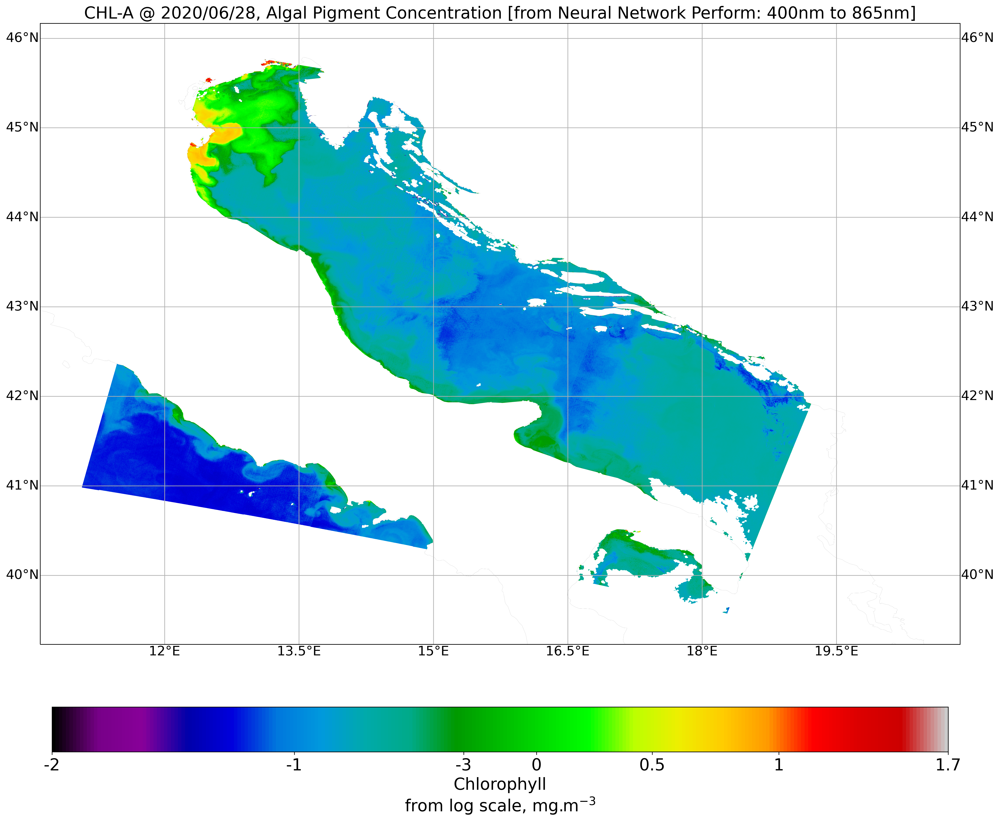

In [42]:
CHL_subset[np.isfinite(FLAG_subset)] = np.nan

fig3 = plt.figure(figsize=(20, 20), dpi=300)
m = plt.axes(projection=ccrs.PlateCarree(),facecolor='w')
f1 = plt.pcolormesh(LON_subset,LAT_subset,np.ma.masked_invalid(CHL_subset), shading='flat', vmin=np.log10(0.01), vmax=np.log10(50), cmap=plt.cm.nipy_spectral)  
m.coastlines(resolution=land_resolution, color='black', linewidth=1)
m.add_feature(land_cop)
g1 = m.gridlines(draw_labels = True)
g1.xlabels_top = False
g1.xlabel_style = {'size': 16, 'color': 'k'}
g1.ylabel_style = {'size': 16, 'color': 'k'}
cbar = plt.colorbar(f1, orientation="horizontal", fraction=0.05, pad=0.07, ticks=[np.log10(0.01), np.log10(0.1),np.log10(0.5), np.log10(1),np.log10(3),np.log10(10),np.log10(50)]) 
cbar.ax.set_xticklabels(['-2','-1','-3','0','0.5','1','1.7'], fontsize=20) 
cbar.set_label('Chlorophyll\nfrom log scale, mg.m$^{-3}$', fontsize=20)
plt.title('CHL-A @ 2020/06/28, Algal Pigment Concentration [from Neural Network Perform: 400nm to 865nm]', fontsize=20);
plt.show()

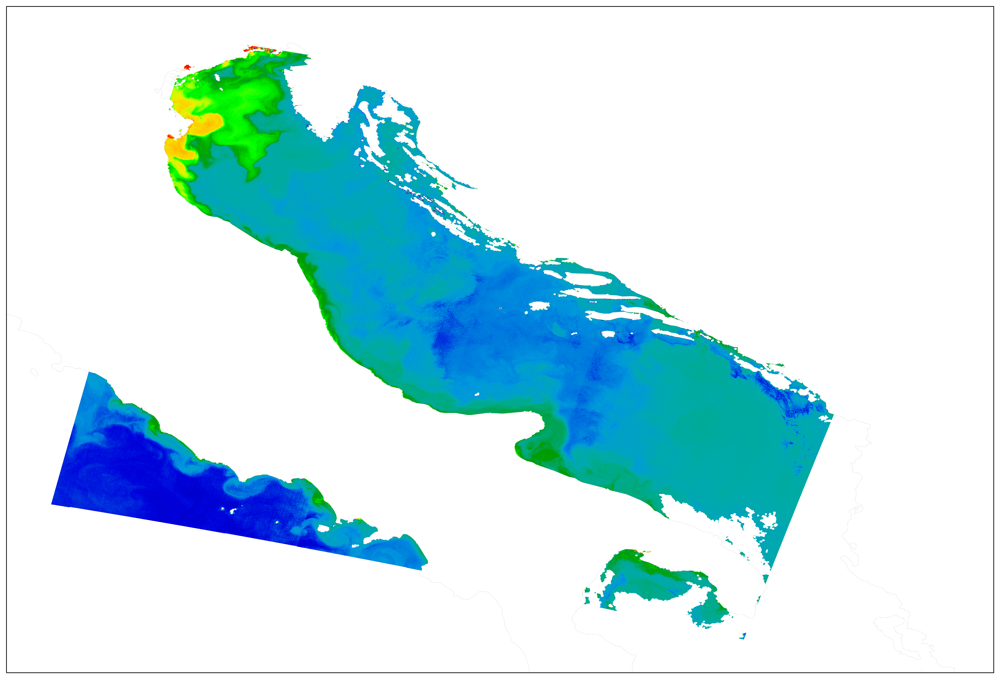

In [43]:
CHL_subset[np.isfinite(FLAG_subset)] = np.nan

fig3 = plt.figure(figsize=(20, 20), dpi=300)
m = plt.axes(projection=ccrs.PlateCarree(),facecolor='w')
f1 = plt.pcolormesh(LON_subset,LAT_subset,np.ma.masked_invalid(CHL_subset), shading='flat', vmin=np.log10(0.01), vmax=np.log10(50), cmap=plt.cm.nipy_spectral)  
m.coastlines(resolution=land_resolution, color='black', linewidth=1)
m.add_feature(land_cop)

plt.show()

In [46]:
from matplotlib.offsetbox import AnchoredText
from matplotlib.pyplot import figure

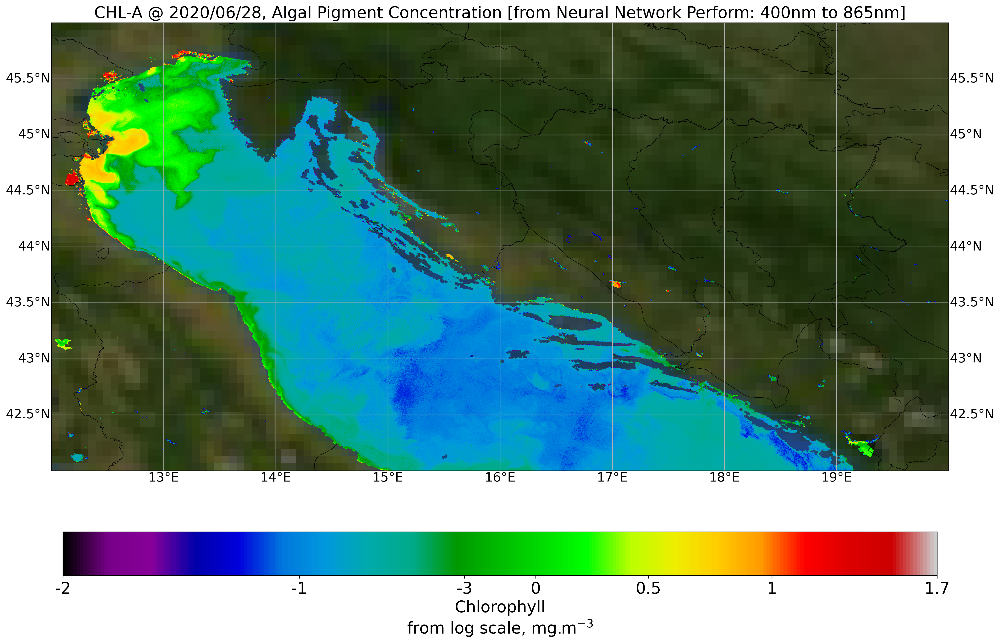

In [57]:
from mpl_toolkits.basemap import Basemap
from numpy import linspace
from numpy import meshgrid

def main():
    k = plt.axes(projection=ccrs.PlateCarree())
    
    k.set_extent([12, 22, 37, 46])
    
    f1 = plt.pcolormesh(LON_subset,LAT_subset,np.ma.masked_invalid(CHL_subset), shading='flat', vmin=np.log10(0.01), vmax=np.log10(50), cmap=plt.cm.nipy_spectral)
    k.stock_img()


    m = Basemap(projection='cyl', resolution='f', 
    llcrnrlat=42, urcrnrlat=46,
    llcrnrlon=12, urcrnrlon=20)
    
    m.bluemarble(scale=0.3, alpha=0.9);     
    m.shadedrelief()
    m.drawcountries()
    m.drawcounties()
    m.drawrivers()
    m.drawstates()
    m.warpimage()

    g1 = k.gridlines(draw_labels = True)
    g1.xlabels_top = False
    g1.xlabel_style = {'size': 16, 'color': 'k'}
    g1.ylabel_style = {'size': 16, 'color': 'k'}
    
    cbar = plt.colorbar(f1, orientation="horizontal", fraction=0.05, pad=0.07, ticks=[np.log10(0.01), np.log10(0.1),np.log10(0.5), np.log10(1),np.log10(3),np.log10(10),np.log10(50)]) 
    cbar.ax.set_xticklabels(['-2','-1','-3','0','0.5','1','1.7'], fontsize=20) 
    cbar.set_label('Chlorophyll\nfrom log scale, mg.m$^{-3}$', fontsize=20)
    plt.title('CHL-A @ 2020/06/28, Algal Pigment Concentration [from Neural Network Perform: 400nm to 865nm]', fontsize=20);    

    plt.show()

figx = plt.figure(figsize=(20, 20), dpi=300)

if __name__ == '__main__':
    main()
    